In [8]:
import os
import cv2
import matplotlib.pyplot as plt
import pickle
import numpy as np

In [3]:
train_data_directory = r'D:\New Dataset\seg_train'
test_data_directory = r'D:\New Dataset\seg_test'

In [4]:
pred_directoty = r'D:\New Dataset\seg_pred'

In [9]:
categories = ['buildings','forest','glacier','mountain','sea','street']

In [10]:
training_data = []
test_data = []

In [117]:
def make_data(directory,dataName):
    for category in categories:
        path = os.path.join(directory,category)
        label = categories.index(category)
        print(path)

        for img_name in os.listdir(path):
            img_path = os.path.join(path,img_name)
            img = cv2.imread(img_path)

            # img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
            img = cv2.resize(img,(150,150))

            img = np.array(img, dtype = np.float32)
                
            # plt.imshow(img)
            # plt.show()
                
            if dataName == 'training':
                training_data.append([img,label])

            else:
                 test_data.append([img,label])
            

            # try : 
            #     img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
            #     img = cv2.resize(img,(150,150))

            #     img = np.array(img, dtype = np.float32)
                
            #     plt.imshow(img)
            #     plt.show()
                
            #     data.append([img,label])
            #     print(len(data))

            # except Exception as e:
            #     pass
                
            # plt.imshow(img)
            # plt.show()
            
            # cv2.imshow('sdsa',img)
            # plt.show()
            # break
    if dataName == 'training':
        print(len(training_data))
        pik = open('training_dataset.pickle','wb')
        pickle.dump(training_data,pik)
        pik.close()

    else:
        print(len(test_data))
        pik = open('test_dataset.pickle','wb')
        pickle.dump(test_data,pik)
        pik.close()
    
    
        # break

    # cv2.waitKey(0)
    # cv2.destroyAllWindows()


In [12]:
make_data(train_data_directory,'training')
make_data(test_data_directory,'test')

D:\New Dataset\seg_train\buildings
D:\New Dataset\seg_train\forest
D:\New Dataset\seg_train\glacier
D:\New Dataset\seg_train\mountain
D:\New Dataset\seg_train\sea
D:\New Dataset\seg_train\street
14034
D:\New Dataset\seg_test\buildings
D:\New Dataset\seg_test\forest
D:\New Dataset\seg_test\glacier
D:\New Dataset\seg_test\mountain
D:\New Dataset\seg_test\sea
D:\New Dataset\seg_test\street
3000


In [10]:
def load_data(dataSetName):
    pick = open(dataSetName,'rb')
    data = pickle.load(pick)
    pick.close()

    np.random.shuffle(data)

    features = []
    labels = []

    for img,label in data:
        features.append(img)
        labels.append(label)

    features = np.array(features,dtype = np.float32)
    labels = np.array(labels,dtype = np.float32)

    features = features / 255.0

    return [features,labels]



In [11]:
x_train,y_train = load_data('training_dataset.pickle')
x_test , y_test = load_data('test_dataset.pickle')

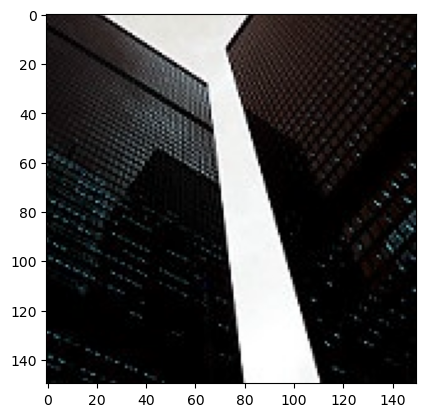

In [13]:
plt.imshow(x_train[2])

In [14]:
x_train.shape

(14034, 150, 150, 3)

In [42]:
y_train[:5]

array([2., 5., 1., 5., 5.], dtype=float32)

In [43]:
y_train = y_train.reshape(-1,)
y_train.shape

(14034,)

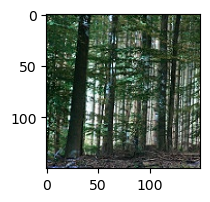

In [44]:
plt.figure(figsize = (15,2))
plt.imshow(x_test[1])

In [15]:
def plot_sample(x,y,index):
    plt.figure(figsize = (15,2))
    plt.imshow(x[index])
    plt.xlabel(categories[int(y[index])]) # for labeling by name
    # plt.xlabel(classes[y[index]])


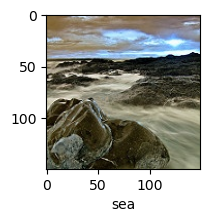

In [16]:
plot_sample(x_train,y_train,0)

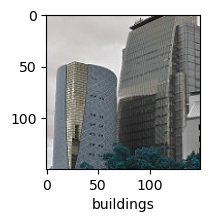

In [17]:
plot_sample(x_train,y_train,7)

In [48]:
from tensorflow.keras import datasets, layers , models
from sklearn.metrics import confusion_matrix , classification_report

In [50]:
#CNN Mode3l

#Implementation of CNN
cnn = models.Sequential([
    layers.Conv2D(filters=32, kernel_size=(3, 3),padding = 'same', activation='relu', input_shape=(150, 150, 3)), # this can detect 32 different features
    layers.MaxPooling2D(pool_size = (2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3),padding = 'same', activation='relu'),
    layers.MaxPooling2D(pool_size = (2, 2),strides = (2,2)),

    layers.Conv2D(filters=96, kernel_size=(3, 3),padding = 'same', activation='relu'),
    layers.MaxPooling2D(pool_size = (2, 2),strides = (2,2)),

    layers.Conv2D(filters=96, kernel_size=(3, 3),padding = 'same', activation='relu'),
    layers.MaxPooling2D(pool_size = (2, 2),strides = (2,2)),
    
    layers.Flatten(),
    layers.Dense(512, activation='relu'),
    layers.Dense(6, activation='softmax')
])

In [51]:
#Compile 

cnn.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])



In [52]:
#train our model

cnn.fit(x_train, y_train,batch_size = 100, epochs=20)


Epoch 1/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 70s 471ms/step - accuracy: 0.4876 - loss: 1.2716
Epoch 2/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 63s 446ms/step - accuracy: 0.7361 - loss: 0.7331
Epoch 3/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 63s 445ms/step - accuracy: 0.7960 - loss: 0.5526
Epoch 4/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 64s 453ms/step - accuracy: 0.8315 - loss: 0.4621
Epoch 5/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 65s 463ms/step - accuracy: 0.8778 - loss: 0.3464
Epoch 6/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 64s 454ms/step - accuracy: 0.8968 - loss: 0.2925
Epoch 7/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 63s 449ms/step - accuracy: 0.9180 - loss: 0.2308
Epoch 8/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 63s 450ms/step - accuracy: 0.9419 - loss: 0.1661
Epoch 9/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 64s 450ms/step - accuracy: 0.9510 - loss: 0.1407
Epoch 10/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 63s 448ms/step - accuracy: 0.9726 - loss: 0.0867
Epoch 11/20
141/141 ━━━━━━━━━━━━━━━━━━━━ 64s 450ms/step - accuracy: 0.9723 - loss: 0.0766
Epoch 12/20
141/141

In [53]:
#Test

cnn.evaluate(x_test,y_test)

94/94 ━━━━━━━━━━━━━━━━━━━━ 5s 40ms/step - accuracy: 0.8500 - loss: 0.9346


[1.0082812309265137, 0.8423333168029785]

In [56]:
y_test[:5]

array([1., 1., 1., 1., 3.], dtype=float32)

In [18]:
y_test = y_test.reshape(-1,)

In [57]:
y_test.shape

(3000,)

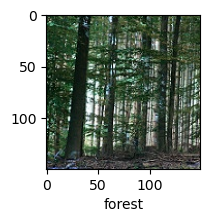

In [58]:
plot_sample(x_test,y_test,1)

In [ ]:
x_pred[:5]


In [83]:
prediction = cnn.predict(x_test)

94/94 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step


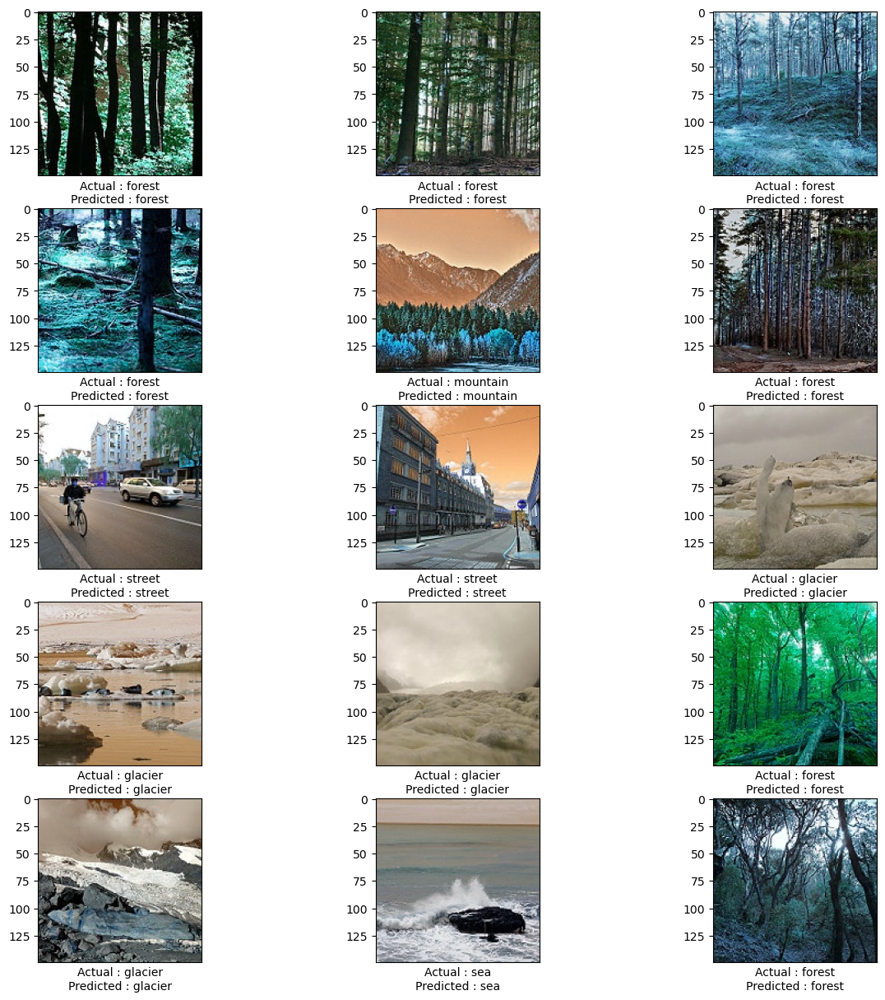

In [91]:
plt.figure(figsize=(15,15))

for i in range(15):
    plt.subplot(5,3,i+1)
    plt.xlabel('Actual : '+categories[int(y_test[i])] + '\n'+'Predicted : '+categories[np.argmax(prediction[i])])
    plt.imshow(x_test[i])
    

    plt.xticks([])

plt.show()

In [19]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory
import numpy as np
import os

# Define image properties
img_height = 150  # Example height (change according to your model input)
img_width = 150   # Example width (change according to your model input)

# Load prediction dataset (x_pred) from directory
prediction_dataset = image_dataset_from_directory(
    r'D:\New Dataset\seg_pred',  # directory containing your prediction images
    image_size=(img_height, img_width), 
    batch_size=32,  # Set batch size as per need
    label_mode=None  # No labels for predictions
)

# Preprocess: Normalize images (scaling between 0 and 1)
prediction_dataset = prediction_dataset.map(lambda x: x / 255.0)

# Load your trained CNN model
cnn_model = tf.keras.models.load_model('CnnModel.keras')

# Predict
predictions = cnn_model.predict(prediction_dataset)

# (Optional) If you want to extract the predicted class for each image:
predicted_classes = np.argmax(predictions, axis=-1)

print(predicted_classes)

Found 7301 files.
229/229 ━━━━━━━━━━━━━━━━━━━━ 10s 42ms/step
[3 2 4 ... 4 2 5]


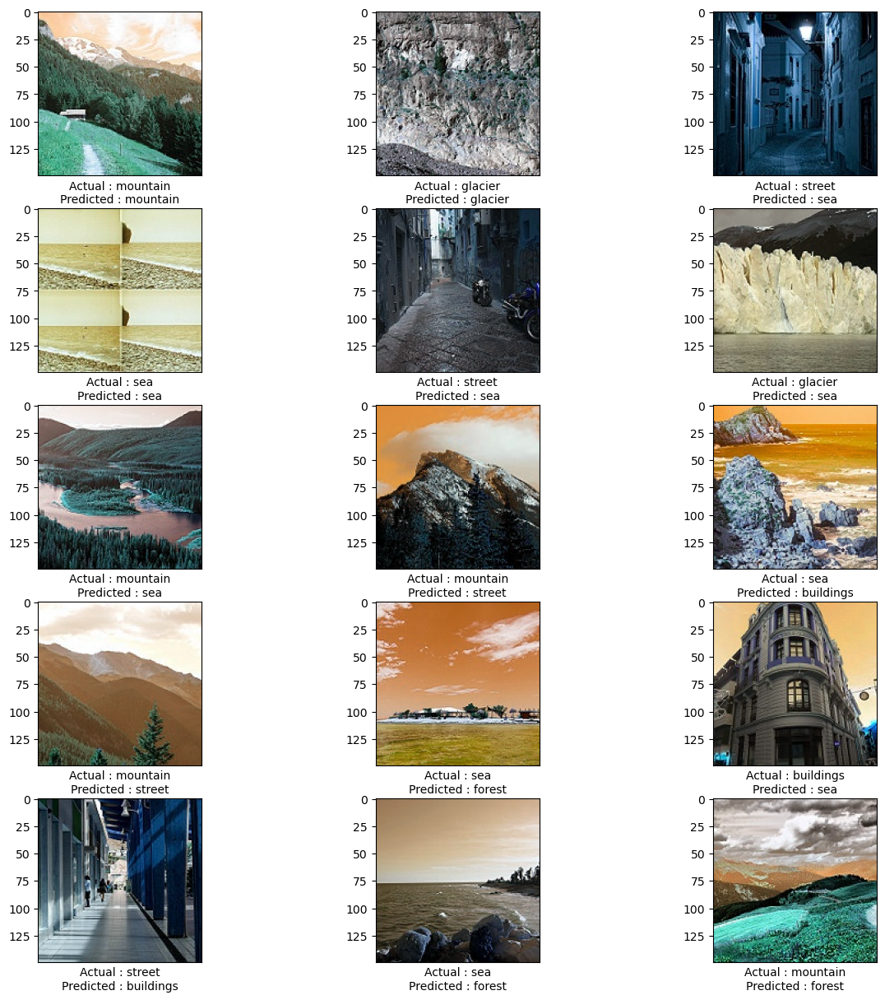

In [20]:
plt.figure(figsize=(15,15))

for i in range(15):
    plt.subplot(5,3,i+1)
    plt.xlabel('Actual : '+categories[int(y_test[i])] + '\n'+'Predicted : '+categories[np.argmax(predictions[i])])
    plt.imshow(x_test[i])
    

    plt.xticks([])

plt.show()

In [100]:
cnn.save('CnnModel.keras')

In [1]:
from tensorflow.keras.models import load_model

In [3]:
my_CNN_model = load_model('CnnModel.keras')

In [107]:
my_CNN_model.summary

<bound method Model.summary of <Sequential name=sequential_1, built=True>>

In [14]:
#Predicting with ramndom image

from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt
import pickle

In [19]:
img_path = r'D:\New Dataset\seg_pred\73.jpg'
img = image.load_img(img_path, target_size=(150, 150))

# Convert image to array and normalize
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # Reshape for model input
img_array /= 255.0  # Normalize pixel values if needed (depends on your model's training preprocessing)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Predicted class: [0]
Predicted label: buildings


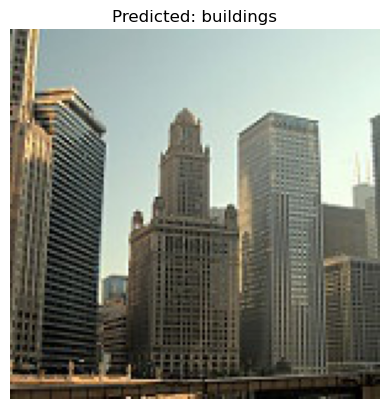

In [18]:
predictions = my_CNN_model.predict(img_array)

# For classification models, use argmax to find the class with the highest probability
predicted_class = np.argmax(predictions, axis=1)

print(f"Predicted class: {predicted_class}")

predicted_label = categories[predicted_class[0]]
print(f"Predicted label: {predicted_label}")

plt.imshow(img)
plt.title(f"Predicted: {predicted_label}")
plt.axis('off')  # Optional: Hide axes
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
Predicted class: [4]
Predicted label: sea


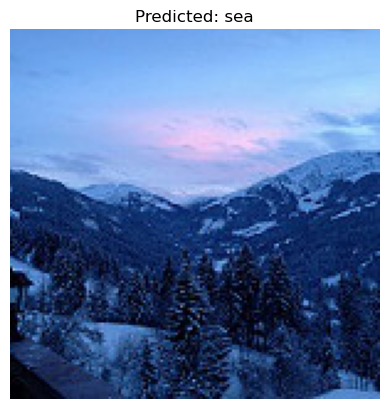

In [7]:
#Import Library

from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
import numpy as np
import matplotlib.pyplot as plt
import os
import pickle


my_CNN_model = load_model('CnnModel.keras') # load model
categories = ['buildings','forest','glacier','mountain','sea','street']

img_path = r'D:\New Dataset\seg_pred\76.jpg'
img = image.load_img(img_path, target_size=(150, 150))

# Convert image to array and normalize
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # Reshape for model input
img_array /= 255.0  # Normalize pixel values if needed (depends on your model's training preprocessing)

predictions = my_CNN_model.predict(img_array)

# For classification models, use argmax to find the class with the highest probability
predicted_class = np.argmax(predictions, axis=1)

print(f"Predicted class: {predicted_class}")

predicted_label = categories[predicted_class[0]]
print(f"Predicted label: {predicted_label}")

plt.imshow(img)
plt.title(f"Predicted: {predicted_label}")
plt.axis('off')  # Optional: Hide axes
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Predicted class: [0]
Predicted label: buildings


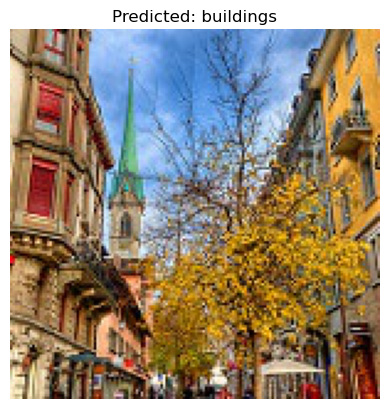

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
Predicted class: [3]
Predicted label: mountain


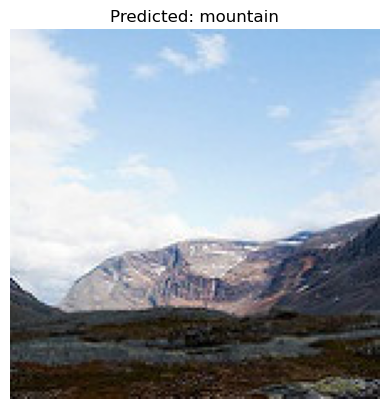

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [0]
Predicted label: buildings


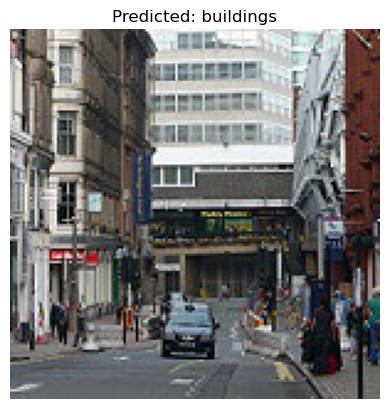

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [0]
Predicted label: buildings


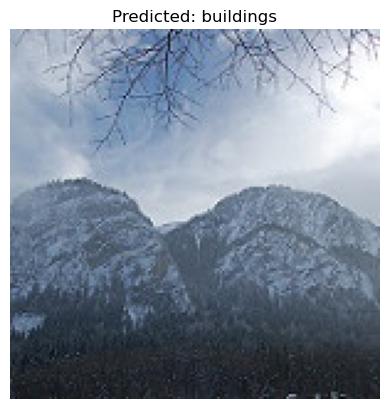

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [2]
Predicted label: glacier


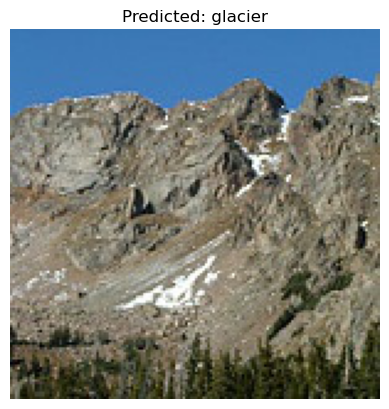

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [1]
Predicted label: forest


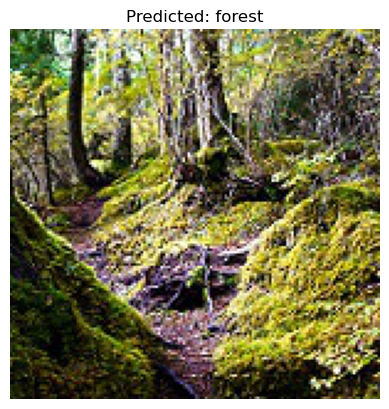

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [4]
Predicted label: sea


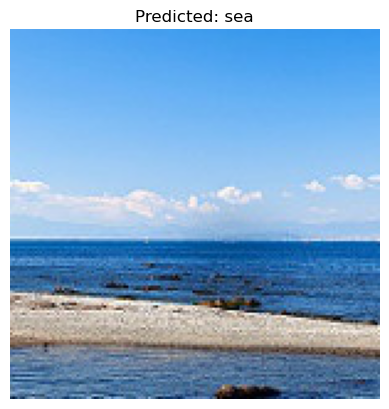

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [2]
Predicted label: glacier


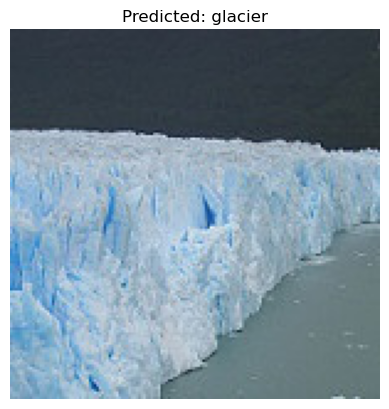

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [4]
Predicted label: sea


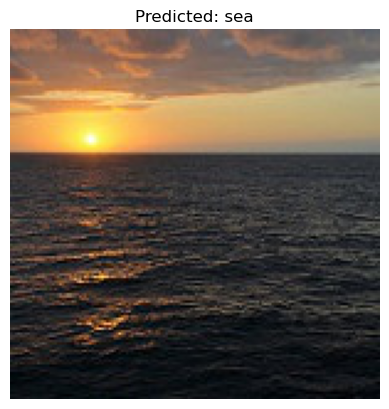

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
Predicted class: [5]
Predicted label: street


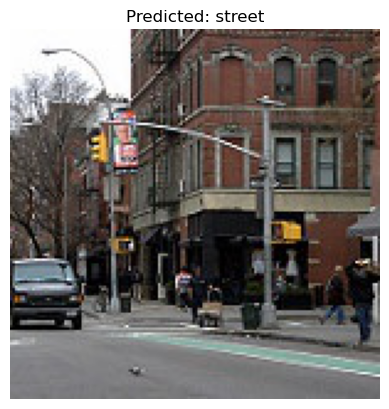

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [4]
Predicted label: sea


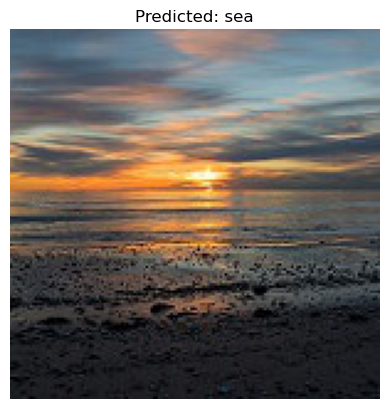

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [5]
Predicted label: street


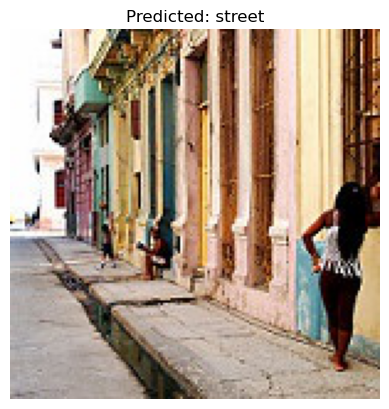

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
Predicted class: [4]
Predicted label: sea


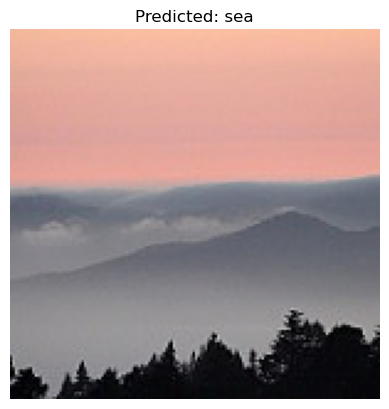

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [0]
Predicted label: buildings


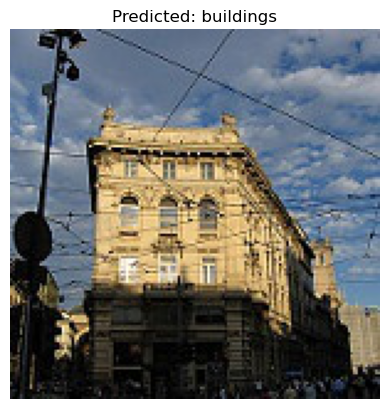

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted class: [0]
Predicted label: buildings


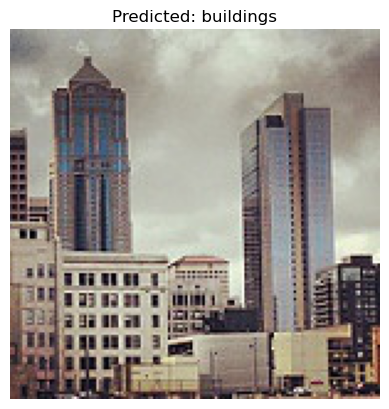

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted class: [0]
Predicted label: buildings


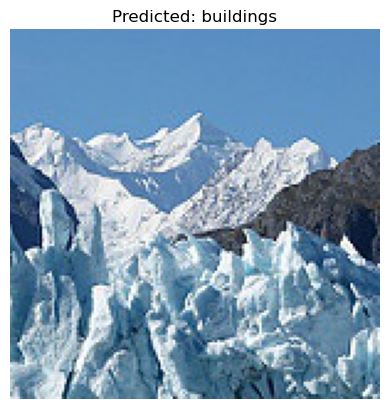

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Predicted class: [1]
Predicted label: forest


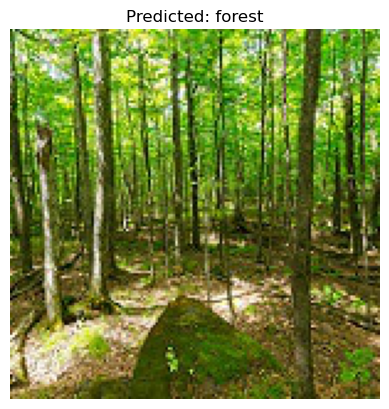

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
Predicted class: [1]
Predicted label: forest


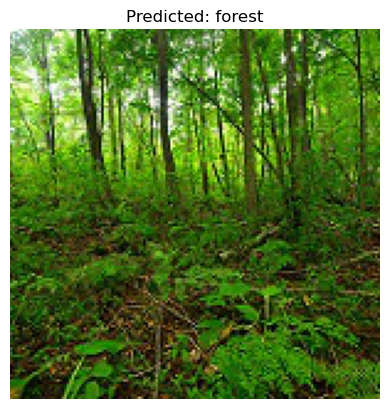

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [4]
Predicted label: sea


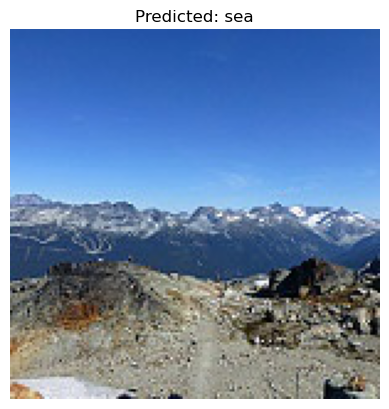

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [4]
Predicted label: sea


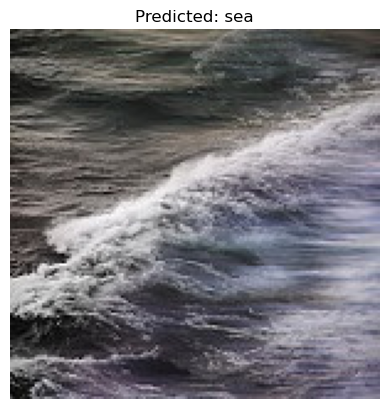

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [1]
Predicted label: forest


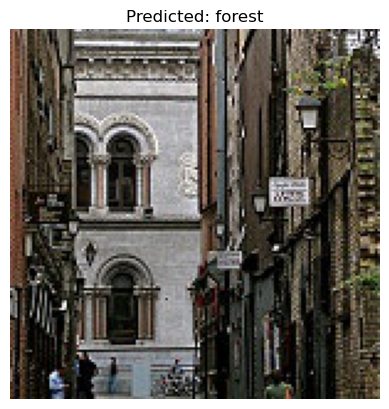

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [5]
Predicted label: street


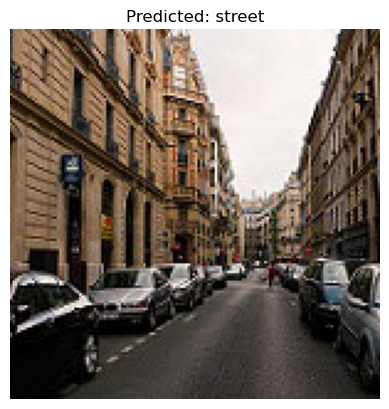

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [5]
Predicted label: street


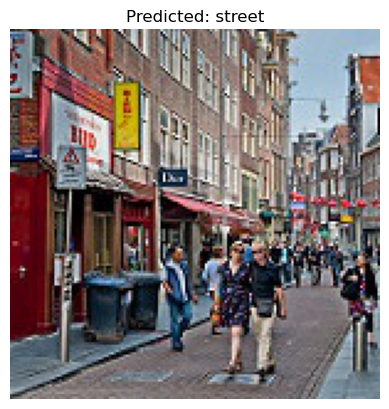

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [5]
Predicted label: street


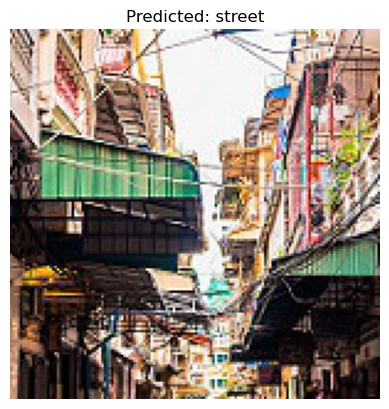

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Predicted class: [0]
Predicted label: buildings


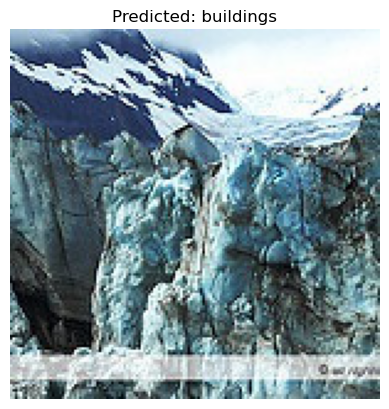

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [0]
Predicted label: buildings


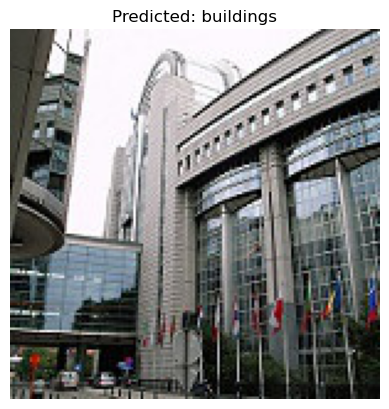

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


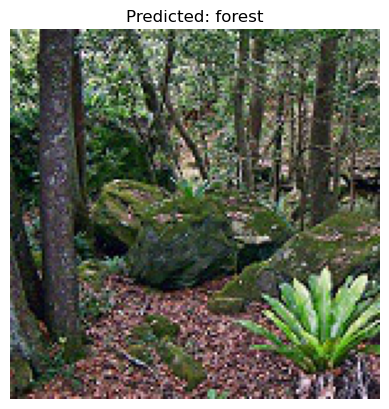

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [3]
Predicted label: mountain


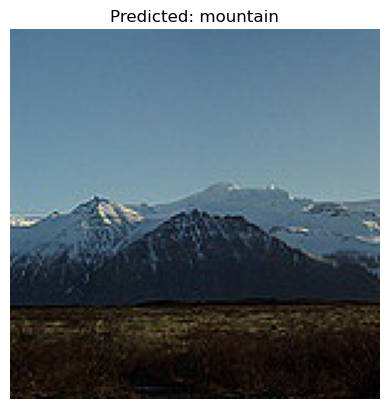

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [3]
Predicted label: mountain


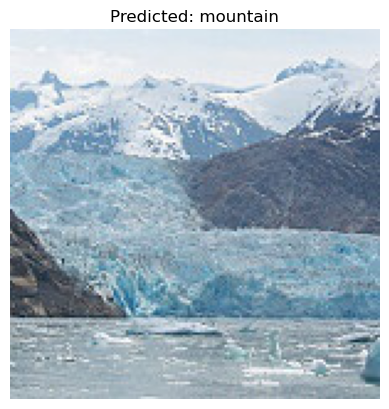

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [3]
Predicted label: mountain


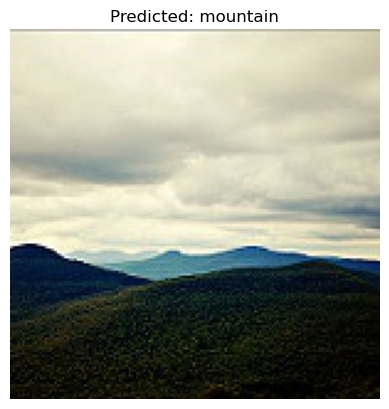

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Predicted class: [3]
Predicted label: mountain


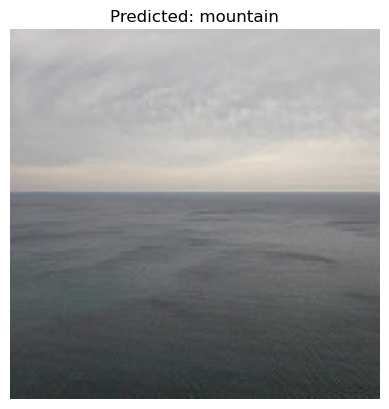

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [4]
Predicted label: sea


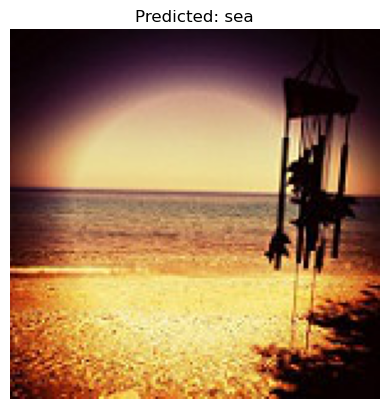

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted class: [4]
Predicted label: sea


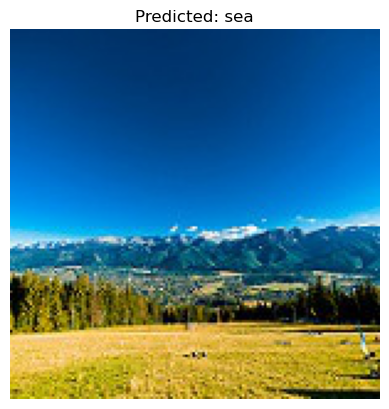

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [4]
Predicted label: sea


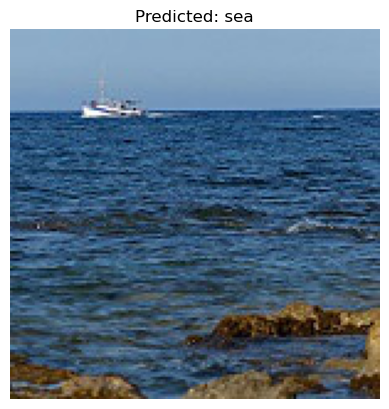

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [4]
Predicted label: sea


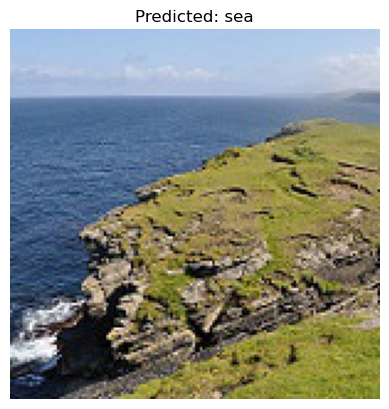

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Predicted class: [3]
Predicted label: mountain


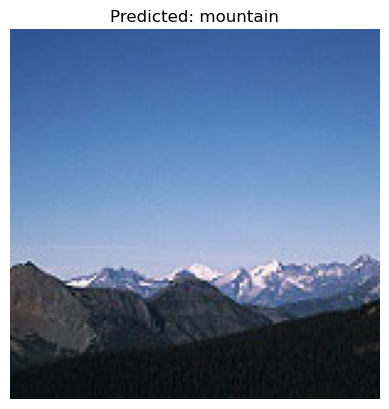

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted class: [4]
Predicted label: sea


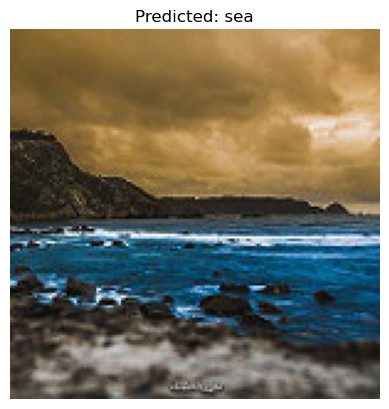

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [4]
Predicted label: sea


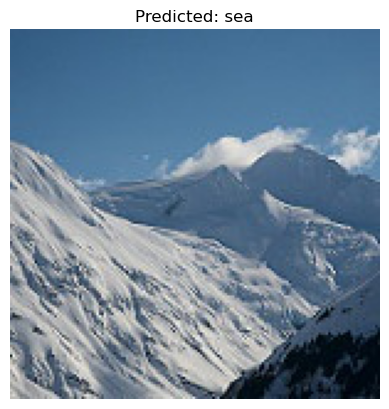

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [4]
Predicted label: sea


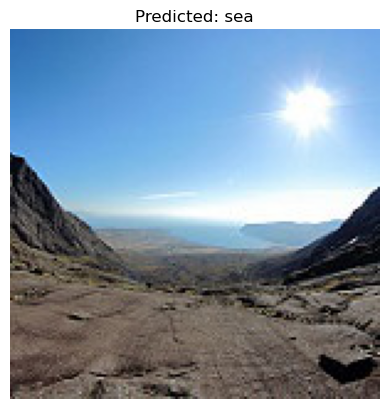

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [1]
Predicted label: forest


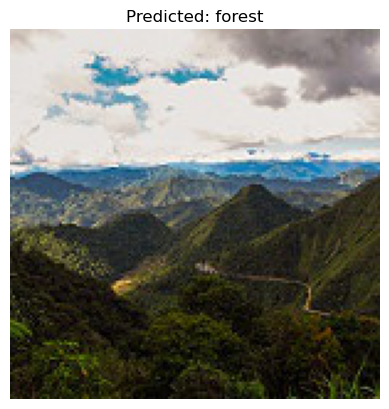

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Predicted class: [4]
Predicted label: sea


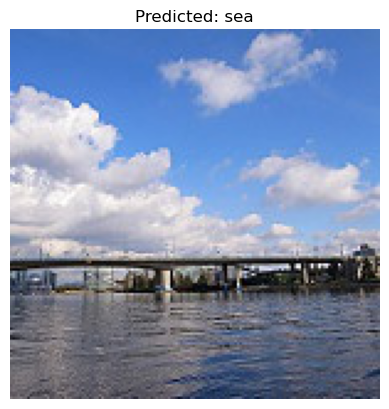

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [5]
Predicted label: street


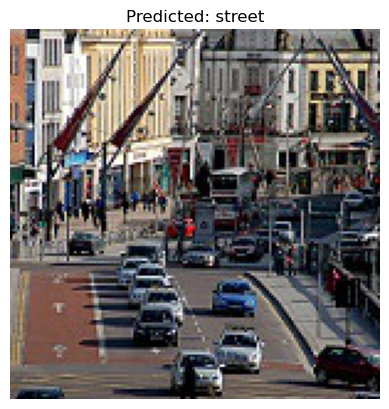

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [2]
Predicted label: glacier


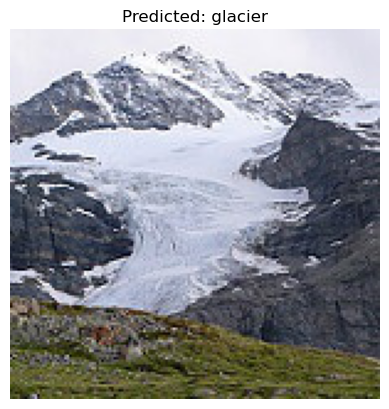

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [3]
Predicted label: mountain


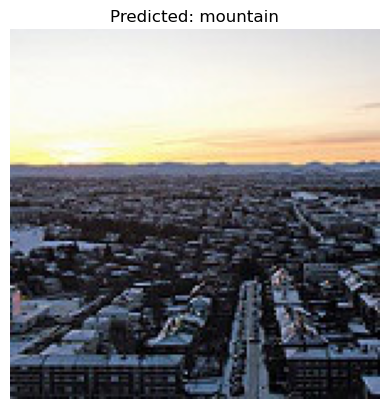

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [4]
Predicted label: sea


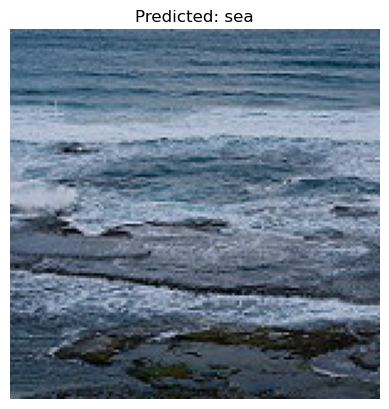

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [1]
Predicted label: forest


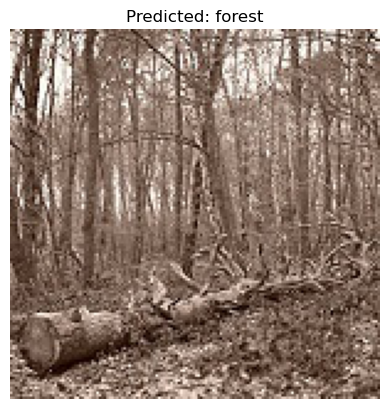

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [4]
Predicted label: sea


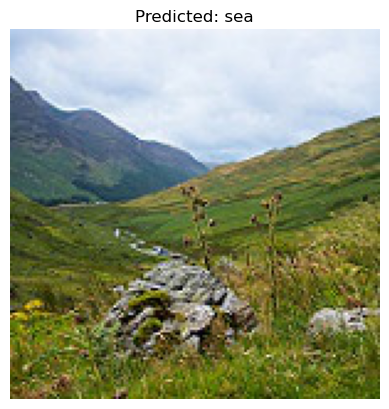

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [2]
Predicted label: glacier


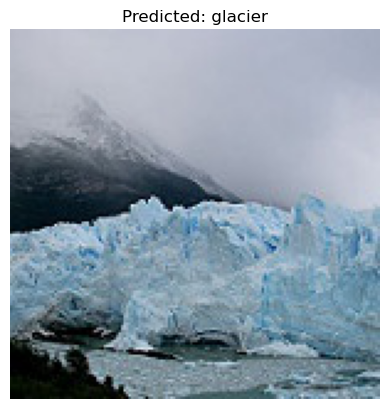

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted class: [5]
Predicted label: street


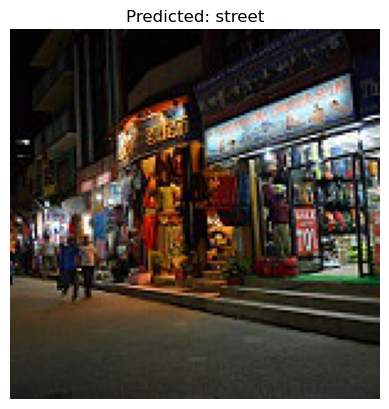

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [3]
Predicted label: mountain


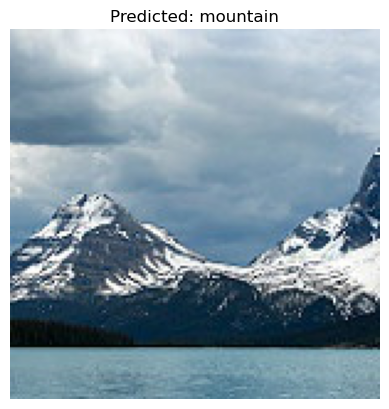

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Predicted class: [0]
Predicted label: buildings


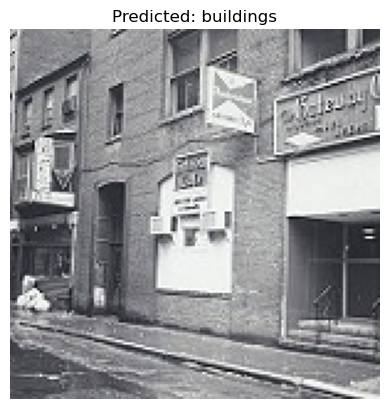

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [0]
Predicted label: buildings


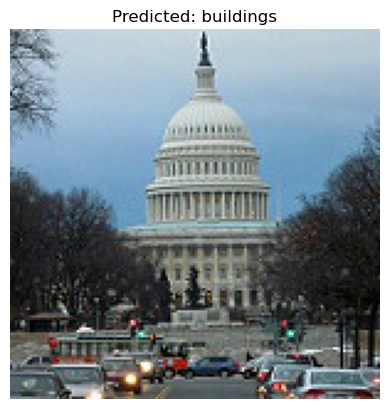

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Predicted class: [1]
Predicted label: forest


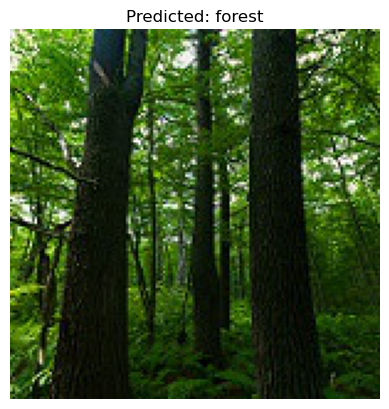

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted class: [0]
Predicted label: buildings


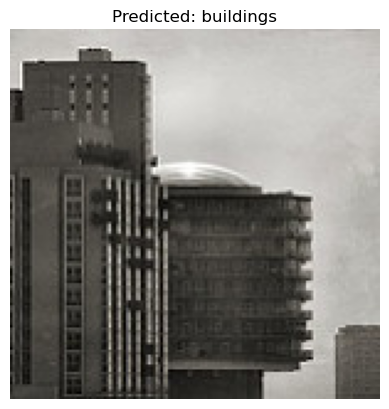

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [1]
Predicted label: forest


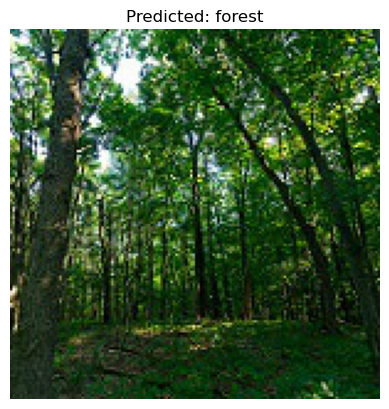

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [4]
Predicted label: sea


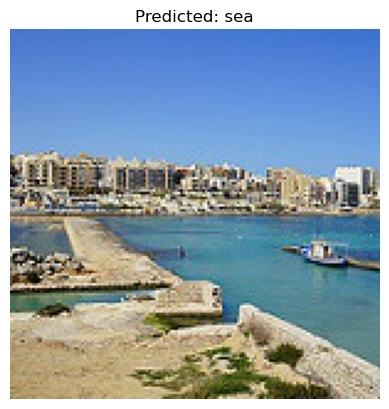

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Predicted class: [1]
Predicted label: forest


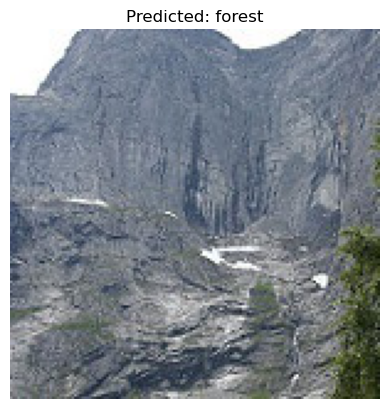

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [5]
Predicted label: street


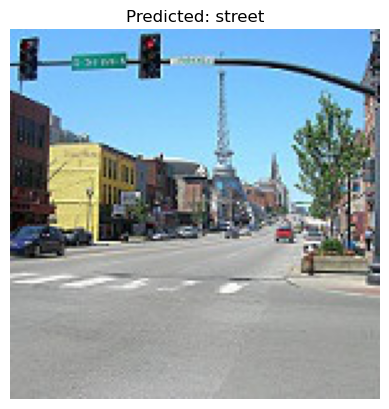

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Predicted class: [0]
Predicted label: buildings


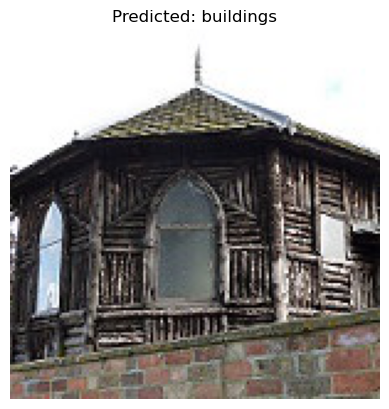

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [5]
Predicted label: street


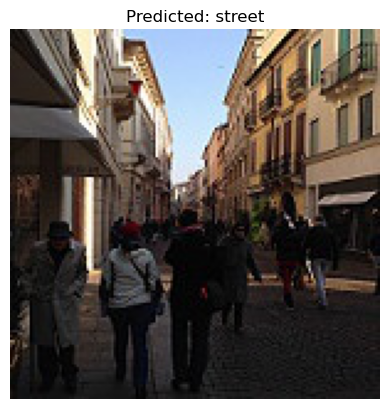

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Predicted class: [0]
Predicted label: buildings


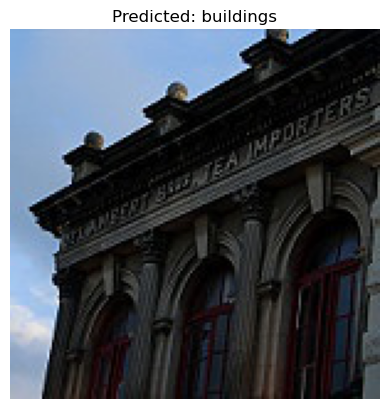

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [1]
Predicted label: forest


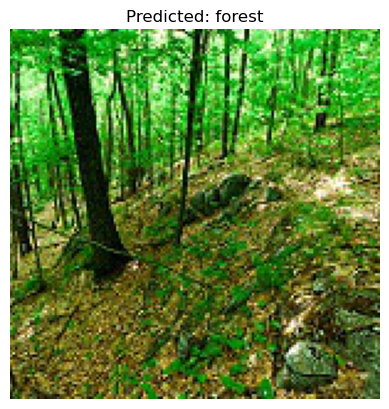

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Predicted class: [5]
Predicted label: street


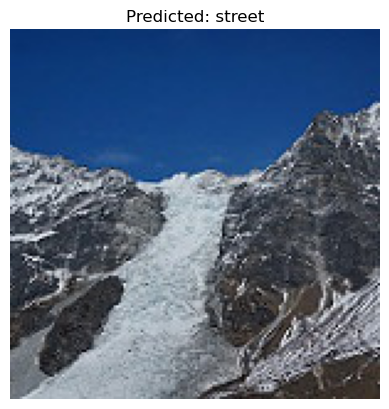

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [0]
Predicted label: buildings


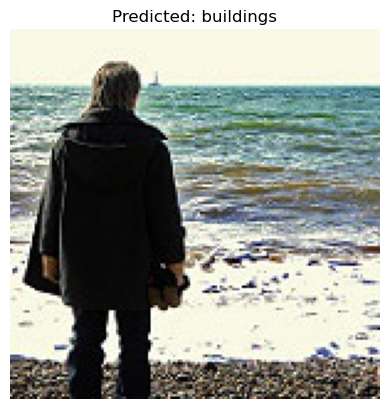

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [1]
Predicted label: forest


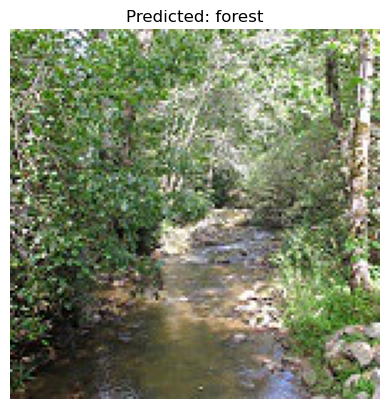

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Predicted class: [3]
Predicted label: mountain


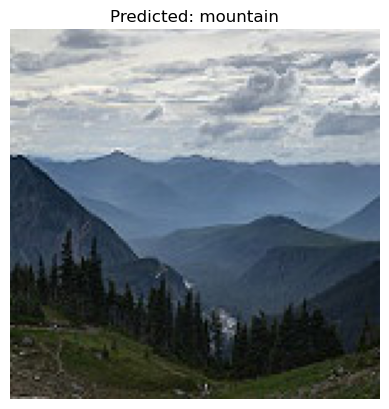

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Predicted class: [2]
Predicted label: glacier


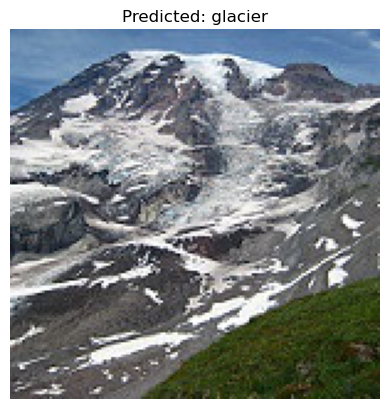

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [5]
Predicted label: street


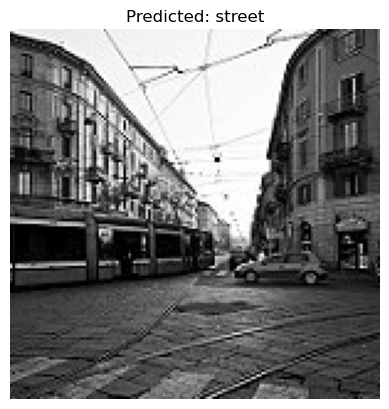

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Predicted class: [1]
Predicted label: forest


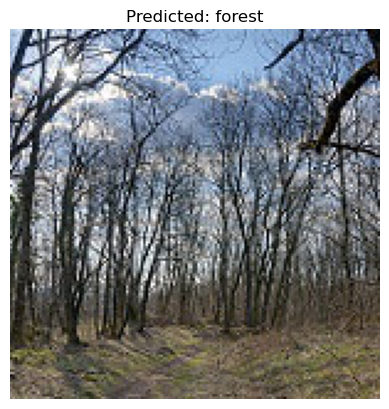

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Predicted class: [5]
Predicted label: street


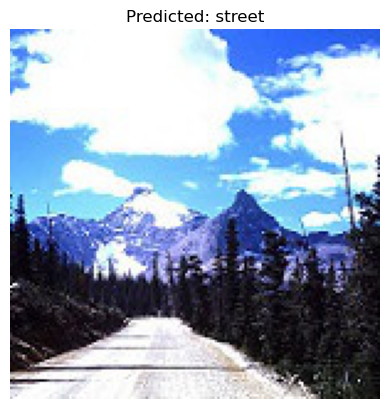

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted class: [1]
Predicted label: forest


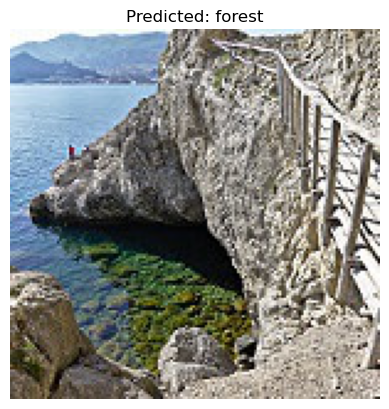

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


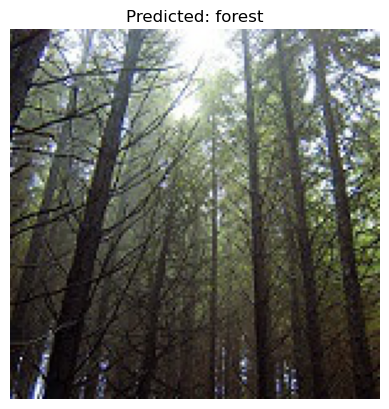

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [2]
Predicted label: glacier


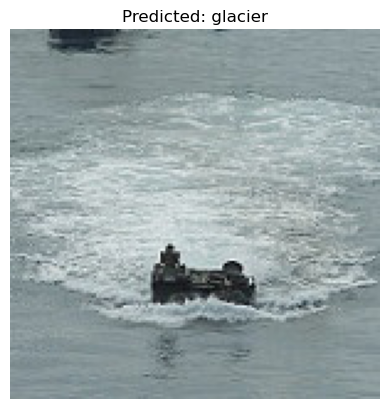

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [5]
Predicted label: street


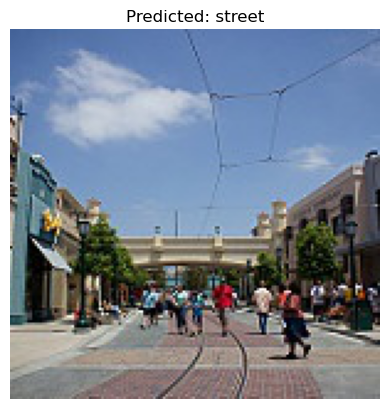

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


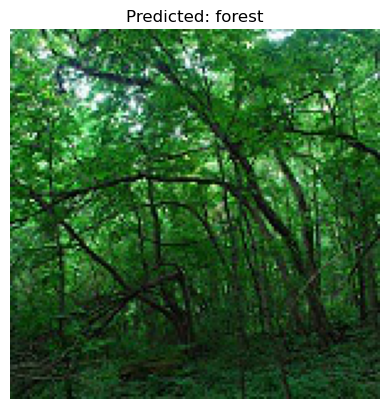

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


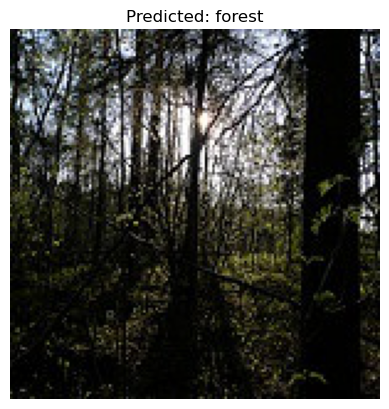

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [3]
Predicted label: mountain


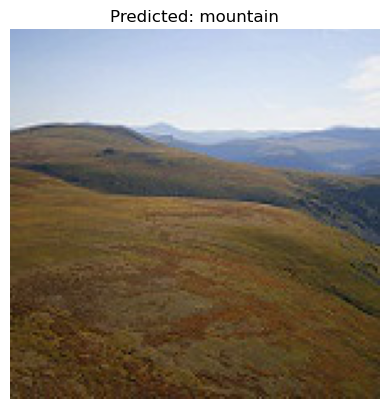

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Predicted class: [4]
Predicted label: sea


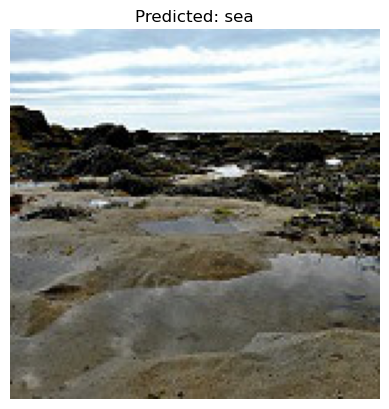

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [2]
Predicted label: glacier


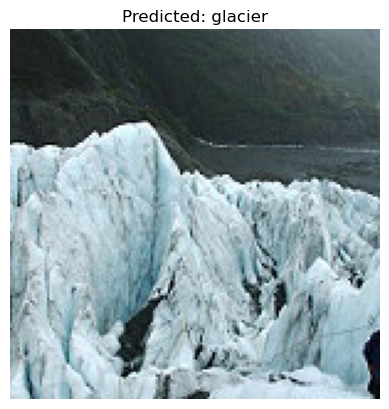

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [2]
Predicted label: glacier


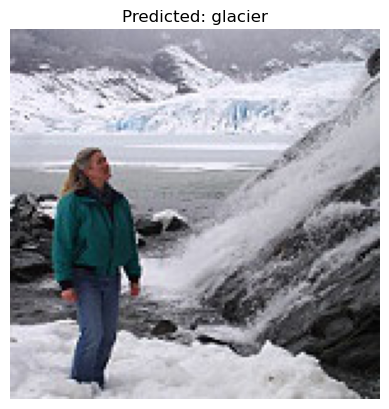

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [5]
Predicted label: street


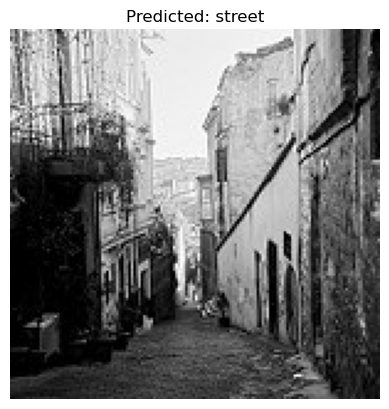

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [2]
Predicted label: glacier


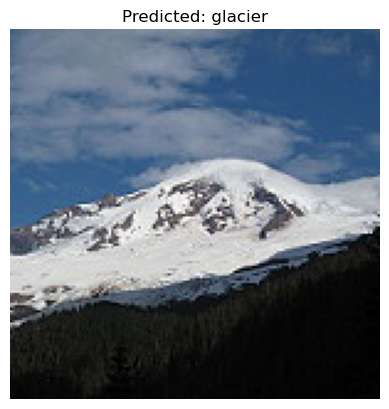

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


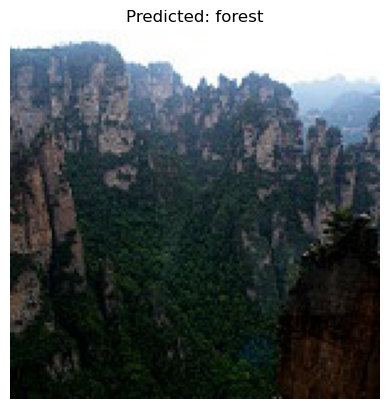

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


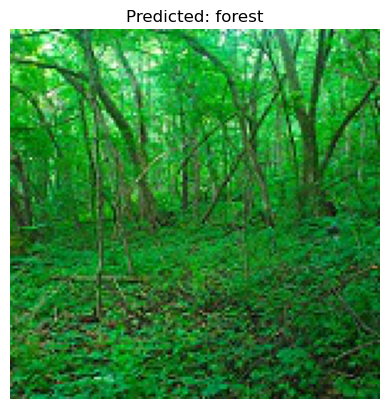

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


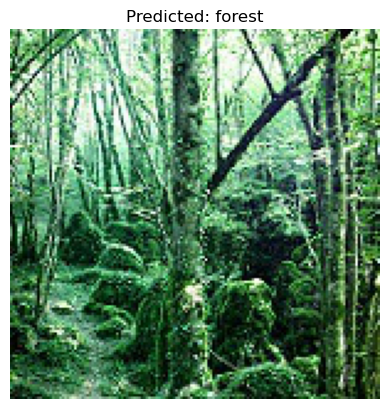

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [3]
Predicted label: mountain


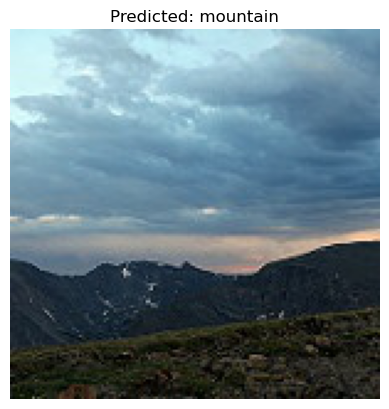

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Predicted class: [0]
Predicted label: buildings


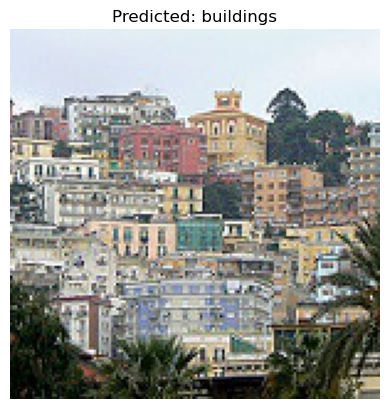

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Predicted class: [1]
Predicted label: forest


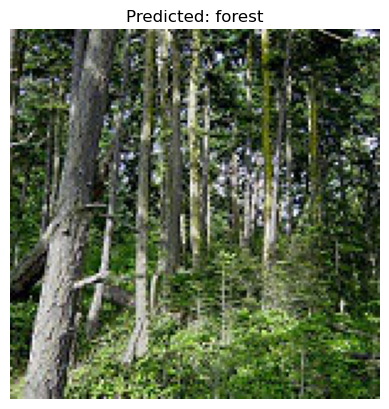

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [4]
Predicted label: sea


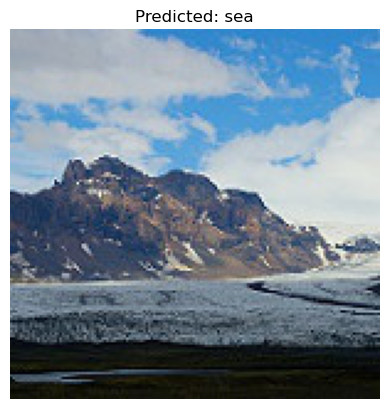

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [0]
Predicted label: buildings


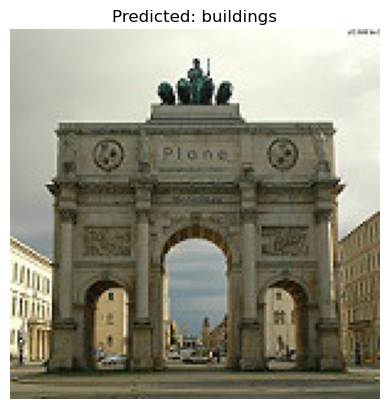

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [3]
Predicted label: mountain


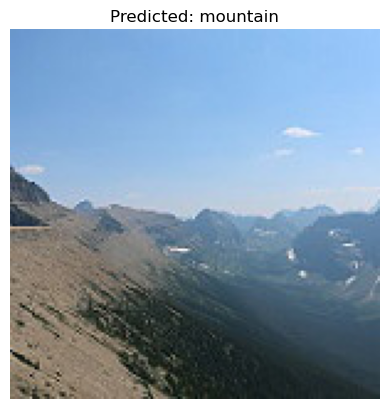

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [0]
Predicted label: buildings


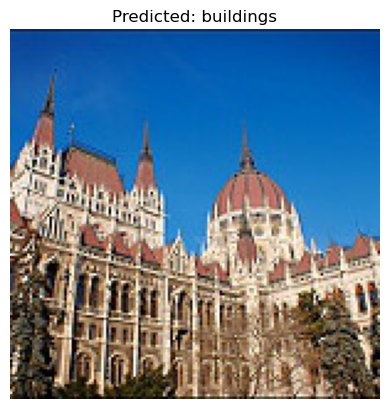

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [2]
Predicted label: glacier


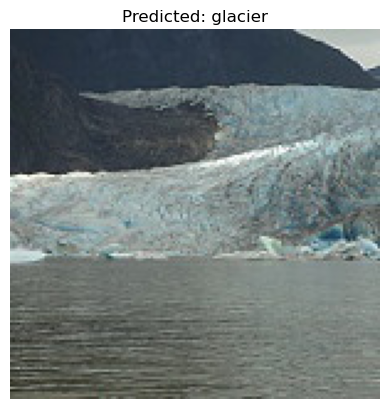

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


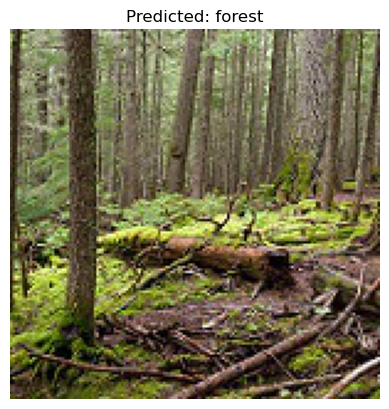

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [1]
Predicted label: forest


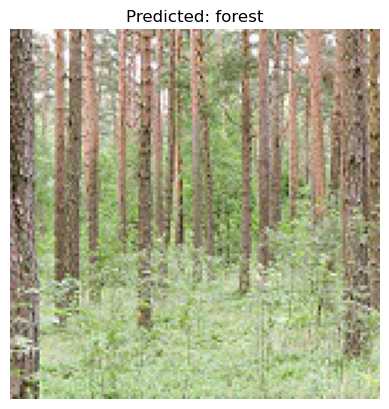

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [0]
Predicted label: buildings


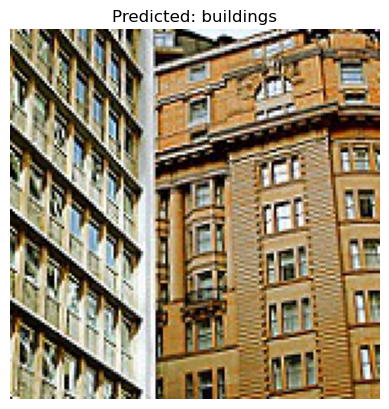

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [4]
Predicted label: sea


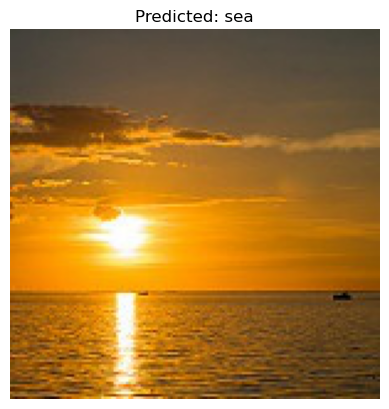

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Predicted class: [3]
Predicted label: mountain


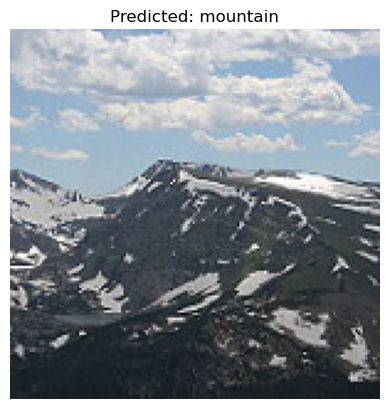

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [4]
Predicted label: sea


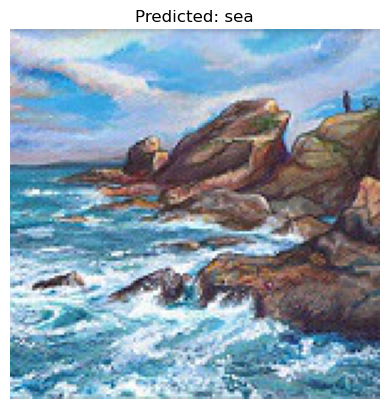

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Predicted class: [0]
Predicted label: buildings


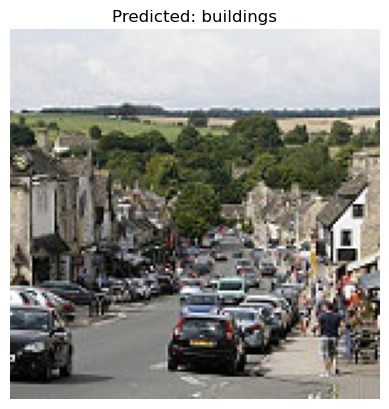

In [4]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
import numpy as np
import matplotlib.pyplot as plt
import os
import pickle

folder = r'D:\New Dataset\seg_pred'

my_CNN_model = load_model('CnnModel.keras') # load model
categories = ['buildings','forest','glacier','mountain','sea','street']


counter = 0;
limit = 100

for img_name in os.listdir(folder):
    img_path = os.path.join(folder,img_name)
    img = image.load_img(img_path, target_size=(150, 150))

    # Convert image to array and normalize
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Reshape for model input
    img_array /= 255.0  # Normalize pixel values if needed (depends on your model's training preprocessing)
    
    predictions = my_CNN_model.predict(img_array)
    
    # For classification models, use argmax to find the class with the highest probability
    predicted_class = np.argmax(predictions, axis=1)
    
    print(f"Predicted class: {predicted_class}")
    
    predicted_label = categories[predicted_class[0]]
    print(f"Predicted label: {predicted_label}")
    
    plt.imshow(img)
    plt.title(f"Predicted: {predicted_label}")
    plt.axis('off')  # Optional: Hide axes
    plt.show()

    # Increment the counter
    counter += 1

    # Break the loop after processing 100 images
    if counter >= limit:
        break
    
    